In [73]:
import torch
import torch.nn as nn
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
import torchvision.transforms as transforms
import torchvision.datasets as datasets
import torchvision.utils as vutils
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
import torch.optim as optim
import torch.nn.functional as F
import numpy as np

In [74]:
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
print("Device:", device)

Device: cuda


In [75]:
# mean = [0.5, 0.5, 0.5]  
# std = [0.5, 0.5, 0.5]   
# 
# 
# reverse_normalize = transforms.Compose([
#     transforms.Normalize(
#         mean=[-m/s for m, s in zip(mean, std)],
#         std=[1/s for s in std]
#     )
# ])

In [76]:
# transform = transforms.Compose([transforms.ToTensor(),transforms.Normalize(mean, std)])
transform = transforms.Compose([transforms.ToTensor()])
dataset = datasets.ImageFolder("trafic_32/", transform=transform)

train_size = int(0.8 * len(dataset)) 
test_size = len(dataset) - train_size
train_set, test_set = torch.utils.data.random_split(dataset, [train_size, test_size])

train_loader = DataLoader(train_set, batch_size=256, shuffle=True, drop_last=True, pin_memory=True, num_workers=4)
test_loader = DataLoader(test_set, batch_size=256, shuffle=False, drop_last=False, num_workers=4)

In [77]:
# Spatial size of training images. All images will be resized to this size using a transformer.
image_size = 32

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 90

# Learning rate for optimizers
lr = 0.0001

# Beta1 hyperparameter for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

In [78]:
class Encoder(nn.Module):
    def __init__(self, input_dim, hidden_dim, latent_dim):
        super(Encoder, self).__init__()

        self.fc_1 = nn.Linear(input_dim, hidden_dim)
        self.fc_2 = nn.Linear(hidden_dim, hidden_dim)
        self.fc_mean = nn.Linear(hidden_dim, latent_dim)
        self.fc_var = nn.Linear(hidden_dim, latent_dim)
        self.LeakyReLU = nn.LeakyReLU(0.2)

    def forward(self, x):
        x = torch.flatten(x, 1)
        x = self.LeakyReLU(self.fc_1(x))
        x = self.LeakyReLU(self.fc_2(x))
        mean = self.fc_mean(x)
        log_var = self.fc_var(x)
        return mean, log_var

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            nn.ConvTranspose2d(nz, ngf * 4, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            nn.ConvTranspose2d(ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
        )

    def forward(self, input):
        return self.main(input)
    
class VAEGAN(nn.Module):
    def __init__(self, encoder, generator):
        super(VAEGAN, self).__init__()
        self.encoder = encoder
        self.generator = generator
    
    def reparameterize(self, mean, var):
        z = torch.randn_like(mean) * var + mean
        return z

    def forward(self, x):
        mean, log_var = self.encoder(x)
        z = self.reparameterize(mean, log_var)
        z = z.unsqueeze(-1).unsqueeze(-1)
        generated_img = self.generator(z)
        return generated_img, mean, log_var

In [79]:
# Initialize encoder and generator
encoder = Encoder(input_dim=image_size*image_size*nc, hidden_dim=256, latent_dim=nz)
generator = Generator(ngpu)

# Initialize VAEGAN
vaegan = VAEGAN(encoder, generator).to(device)

# Define optimizer for VAEGAN
optimizer_vaegan = torch.optim.Adam(vaegan.parameters(), lr=lr, betas=(beta1, 0.999))

# Loss function for reconstruction
reconstruction_loss = nn.MSELoss()

img_list = []
iters = 0
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

for epoch in range(num_epochs):
    vaegan.train()
    total_loss = 0.0
    for i, data in enumerate(train_loader, 0):
        inputs, _ = data
        inputs = inputs.to(device)

        optimizer_vaegan.zero_grad()

        # Forward pass
        generated_imgs, mean, log_var = vaegan(inputs)
        
        # Reconstruction loss
        recon_loss = reconstruction_loss(generated_imgs, inputs)

        # KL divergence loss
        kl_loss = -0.5 * torch.sum(1 + log_var - mean.pow(2) - log_var.exp())

        # Total loss
        loss = recon_loss + kl_loss

        # Backward pass and optimize
        loss.backward()
        optimizer_vaegan.step()

        total_loss += loss.item()
        
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(train_loader)-1)):
            with torch.no_grad():
                fake = vaegan.generator(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
        iters += 1

    print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {total_loss / len(train_loader):.4f}")

Epoch [1/90], Loss: 6.8990
Epoch [2/90], Loss: 1.3316
Epoch [3/90], Loss: 0.4706
Epoch [4/90], Loss: 0.3229
Epoch [5/90], Loss: 0.2919
Epoch [6/90], Loss: 0.2438
Epoch [7/90], Loss: 0.2226
Epoch [8/90], Loss: 0.2012
Epoch [9/90], Loss: 0.1703
Epoch [10/90], Loss: 0.1752
Epoch [11/90], Loss: 0.1597
Epoch [12/90], Loss: 0.1560
Epoch [13/90], Loss: 0.1466
Epoch [14/90], Loss: 0.1419
Epoch [15/90], Loss: 0.1334
Epoch [16/90], Loss: 0.1167
Epoch [17/90], Loss: 0.1173
Epoch [18/90], Loss: 0.1227
Epoch [19/90], Loss: 0.1049
Epoch [20/90], Loss: 0.1002
Epoch [21/90], Loss: 0.1047
Epoch [22/90], Loss: 0.0949
Epoch [23/90], Loss: 0.0870
Epoch [24/90], Loss: 0.0849
Epoch [25/90], Loss: 0.0849
Epoch [26/90], Loss: 0.0787
Epoch [27/90], Loss: 0.0777
Epoch [28/90], Loss: 0.0778
Epoch [29/90], Loss: 0.0729
Epoch [30/90], Loss: 0.0733
Epoch [31/90], Loss: 0.0674
Epoch [32/90], Loss: 0.0669
Epoch [33/90], Loss: 0.0680
Epoch [34/90], Loss: 0.0617
Epoch [35/90], Loss: 0.0598
Epoch [36/90], Loss: 0.0584
E

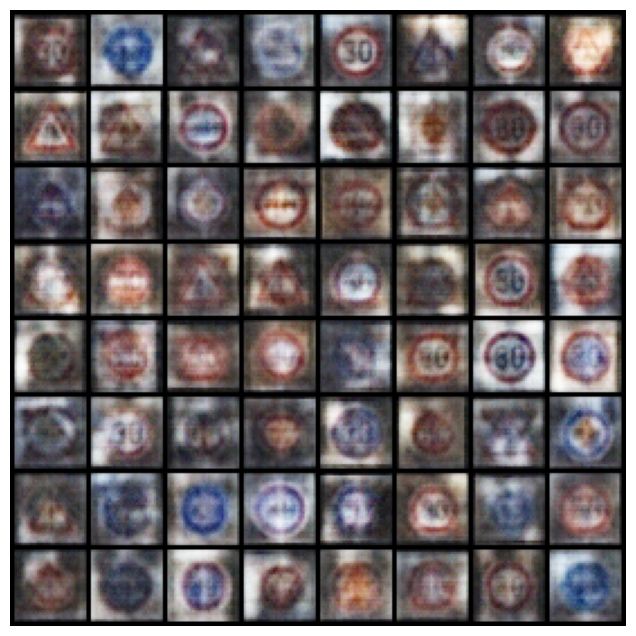

In [80]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

# Ewaluacja modeli generatywnych

In [81]:
class Evaluator(nn.Module):
    def __init__(self, input_dim, hidden_dim):
        super(Evaluator, self).__init__()

        self.fc_1 = nn.Linear(input_dim, hidden_dim)
        self.fc_2 = nn.Linear(hidden_dim, 50)
        self.fc_out  = nn.Linear(50, 43)
        
        self.LeakyReLU = nn.LeakyReLU(0.2)
        
    def get_features(self, x):
        x = torch.flatten(x, 1)
        x = self.LeakyReLU(self.fc_1(x))
        x = self.LeakyReLU(self.fc_2(x))
        return x
    

    def forward(self, x):
        x = self.get_features(x)
        x = self.fc_out(x)
        return x

evaluator = Evaluator(3072, 256).to(device)

In [82]:
# Optimizers
optimizer = torch.optim.Adam(evaluator.parameters(), lr=0.001)
scheduler = optim.lr_scheduler.ExponentialLR(optimizer=optimizer, gamma=0.97)

# loss
evaluator.eval()
criterion = nn.CrossEntropyLoss()
num_epochs = 7
for epoch in range(num_epochs):
    for data, targets in iter(train_loader):
        data = data.to(device)
        targets = targets.to(device)

        results = evaluator(data)
        loss = criterion(results, targets)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

In [83]:
num_correct = 0
total_guesses = 0

evaluator.eval()
with torch.no_grad():
    for data, targets in iter(test_loader):
        # Sends data and targets to device
        data = data.to(device)
        targets = targets.to(device)

        # Acquires the network's best guesses at each class
        results = evaluator(data)
        best_guesses = torch.argmax(results, 1)

        # Updates number of correct and total guesses
        num_correct += torch.eq(targets, best_guesses).sum().item()
        total_guesses += len(targets)

print("Correctly guessed ", num_correct/total_guesses*100, "% of the dataset")

Correctly guessed  89.67100229533283 % of the dataset


In [84]:
with torch.no_grad():
    fixed_noise = torch.randn(1000, nz, 1, 1, device=device)
    fixed_labels = torch.randint(10, (1000,), device=device)
    fixed_labels = F.one_hot(fixed_labels, 10).float()
    generations_vaegan = vaegan.generator(fixed_noise)
    # generations_vaegan = reverse_normalize(generations_vaegan)

# orig_data = [reverse_normalize(x[0]) for x in list(test_set)[:1000]]
orig_data = [x[0] for x in list(test_set)[:1000]]
orig_data = torch.cat(orig_data)
orig_data = orig_data.view(-1, 32*32*3)


with torch.no_grad():
    dist_orig_data = evaluator.get_features(orig_data.to(device)).cpu()
    dist_vaegan = evaluator.get_features(generations_vaegan.to(device)).cpu()

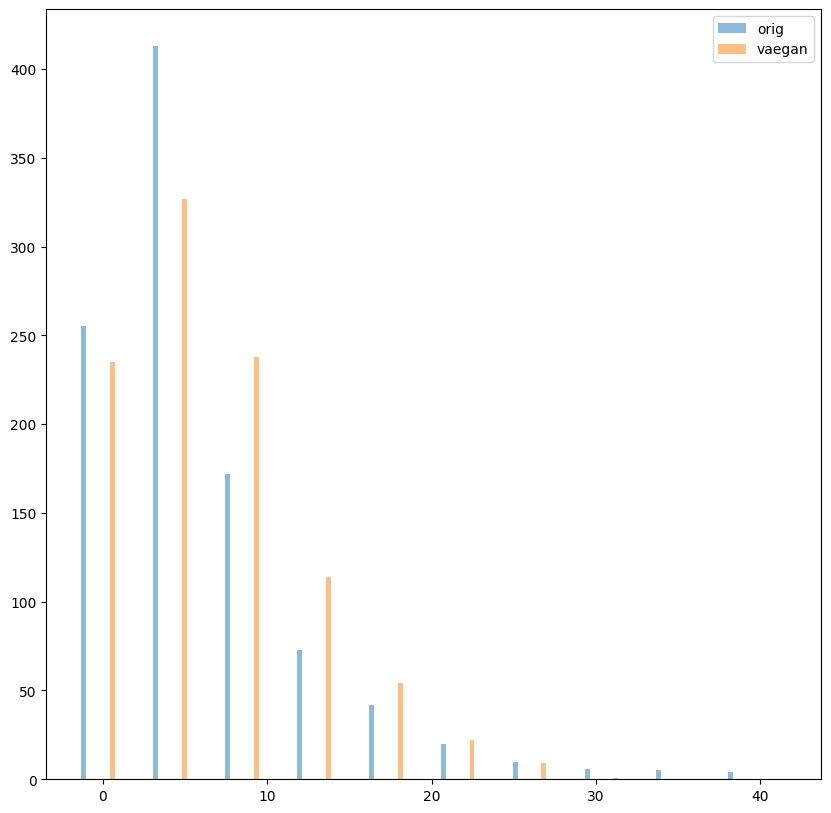

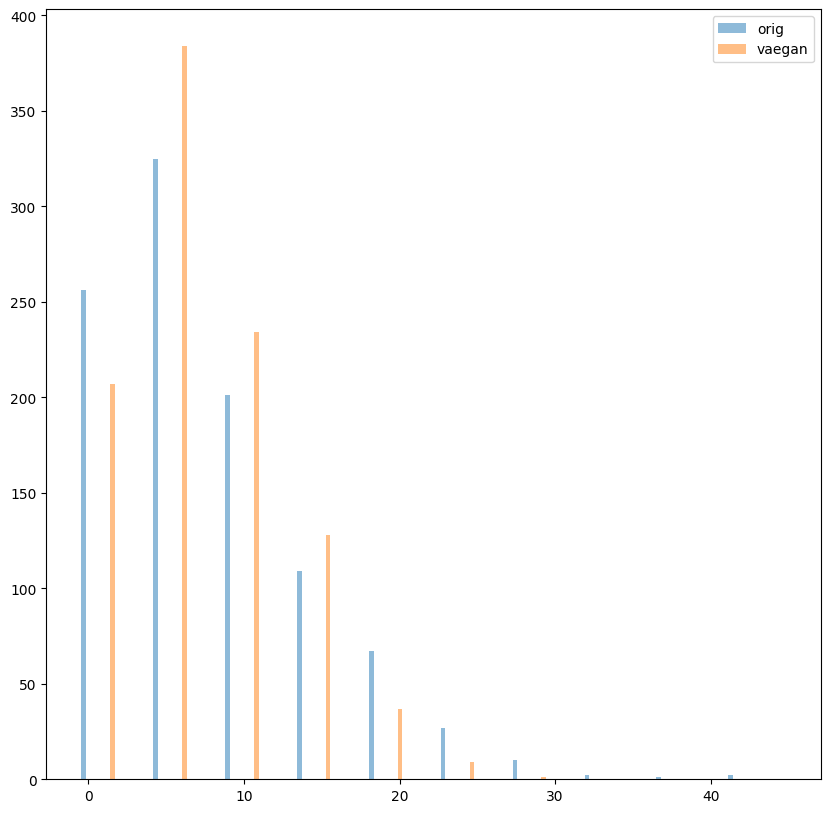

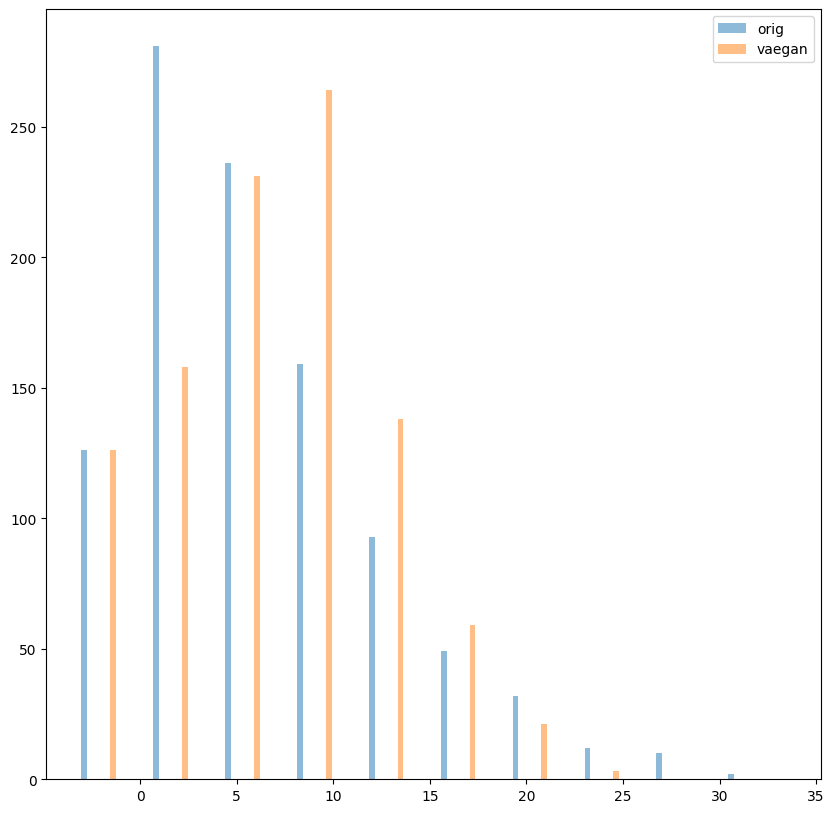

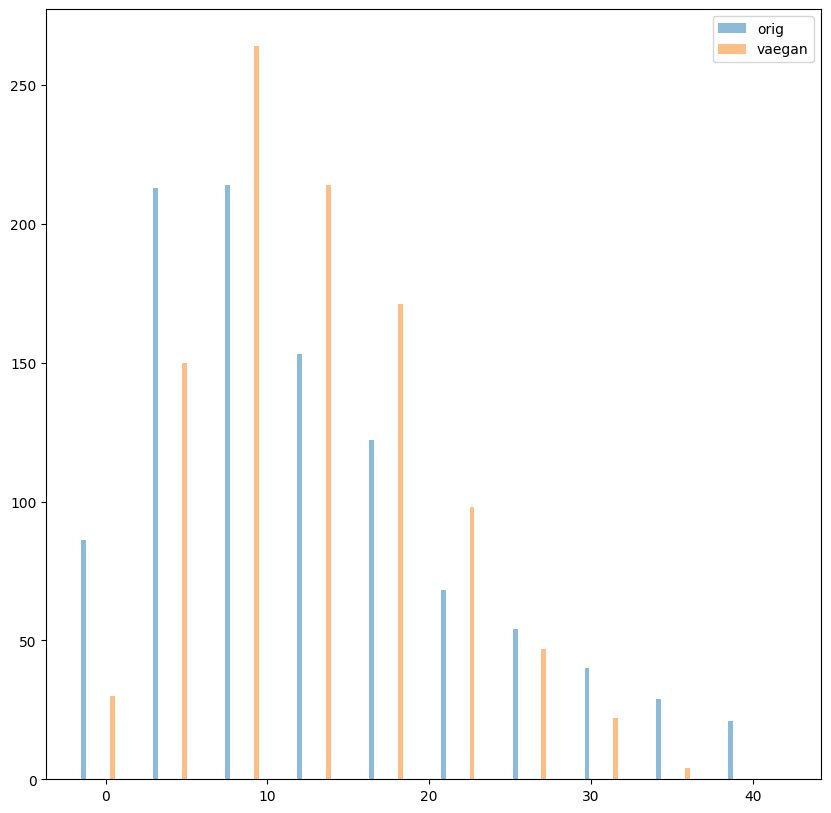

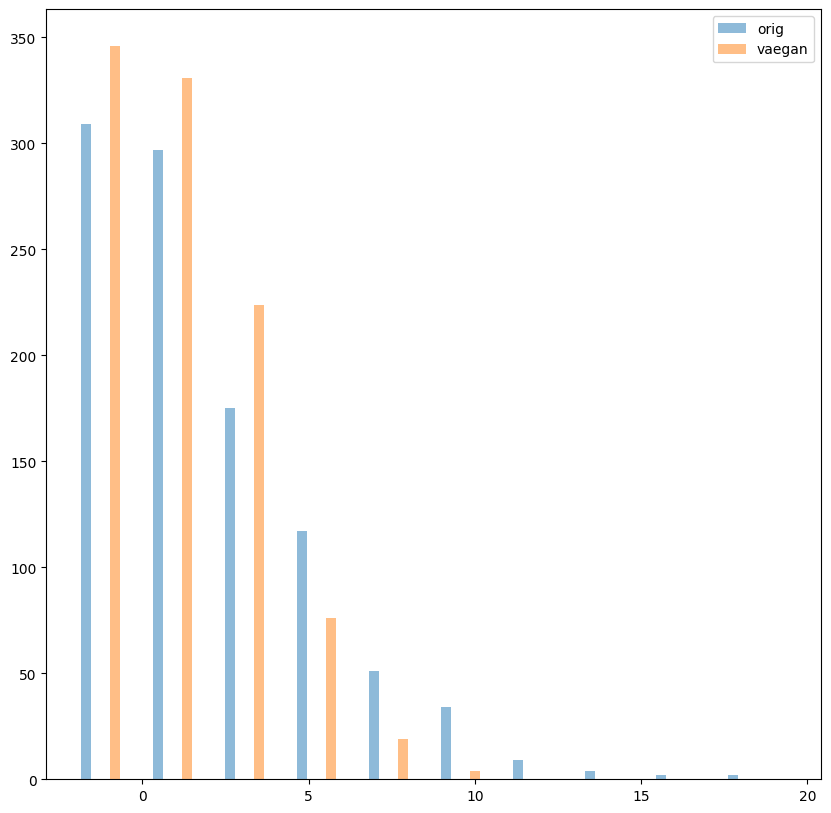

In [85]:
for idx in range(5):
    bins = 10
    w = 0.3
    plt.figure(figsize=(10,10))
    plt.hist([dist_orig_data[:,idx].numpy(),dist_vaegan[:,idx].numpy()], bins, alpha=0.5, label=['orig','vaegan'],width=w)
    plt.legend(loc='upper right')
    plt.show()
    plt.close()

In [86]:
######### Frechet Inception distance based on implementation from https://github.com/mseitzer/pytorch-fid

import numpy as np
from scipy import linalg


def calculate_frechet_distance(distribution_1, distribution_2, eps=1e-6):
    mu1 = np.mean(distribution_1, axis=0)
    sigma1 = np.cov(distribution_1, rowvar=False)

    mu2 = np.mean(distribution_2, axis=0)
    sigma2 = np.cov(distribution_2, rowvar=False)

    """Numpy implementation of the Frechet Distance.
    The Frechet distance between two multivariate Gaussians X_1 ~ N(mu_1, C_1)
    and X_2 ~ N(mu_2, C_2) is
            d^2 = ||mu_1 - mu_2||^2 + Tr(C_1 + C_2 - 2*sqrt(C_1*C_2)).
    Stable version by Dougal J. Sutherland.
    Params:
    -- mu1   : Numpy array containing the activations of a layer of the
               inception net (like returned by the function 'get_predictions')
               for generated samples.
    -- mu2   : The sample mean over activations, precalculated on an
               representative data set.
    -- sigma1: The covariance matrix over activations for generated samples.
    -- sigma2: The covariance matrix over activations, precalculated on an
               representative data set.
    Returns:
    --   : The Frechet Distance.
    """

    mu1 = np.atleast_1d(mu1)
    mu2 = np.atleast_1d(mu2)

    sigma1 = np.atleast_2d(sigma1)
    sigma2 = np.atleast_2d(sigma2)

    assert mu1.shape == mu2.shape, \
        'Training and test mean vectors have different lengths'
    assert sigma1.shape == sigma2.shape, \
        'Training and test covariances have different dimensions'

    diff = mu1 - mu2

    # Product might be almost singular
    covmean, _ = linalg.sqrtm(sigma1.dot(sigma2), disp=False)
    if not np.isfinite(covmean).all():
        msg = ('fid calculation produces singular product; '
               'adding %s to diagonal of cov estimates') % eps
        print(msg)
        offset = np.eye(sigma1.shape[0]) * eps
        covmean = linalg.sqrtm((sigma1 + offset).dot(sigma2 + offset))

    # Numerical error might give slight imaginary component
    if np.iscomplexobj(covmean):
        if not np.allclose(np.diagonal(covmean).imag, 0, atol=1e-3):
            m = np.max(np.abs(covmean.imag))
            raise ValueError('Imaginary component {}'.format(m))
        covmean = covmean.real

    tr_covmean = np.trace(covmean)

    return (diff.dot(diff) + np.trace(sigma1) +
            np.trace(sigma2) - 2 * tr_covmean)

In [87]:
# orig_data_2 = [reverse_normalize(x[0]) for x in list(test_set)[-1000:]]
orig_data_2 = [x[0] for x in list(test_set)[:1000]]
orig_data_2 = torch.cat(orig_data_2)
orig_data_2 = orig_data_2.view(-1, 32*32*3)

with torch.no_grad():
    dist_orig_data_2 = evaluator.get_features(orig_data_2.to(device)).cpu()

In [88]:
for name, obj in zip(['orig','vaegan'],[dist_orig_data_2.numpy(),dist_vaegan.numpy()]):
    print(f"FD {name}: {calculate_frechet_distance(dist_orig_data.numpy(),obj)}")

FD orig: -2.3737811716273427e-10
FD vaegan: 369.59320456318756


In [89]:
with torch.no_grad():
    fixed_noise = torch.randn(1000, nz, 1, 1, device=device)
    generated_samples = vaegan.generator(fixed_noise)
    # generated_samples = reverse_normalize(generated_samples)
    torch.save(generated_samples.cpu().detach(), "poniedzialek_grądziel_misztal.pt")